In [1]:
!pip install gymnasium matplotlib numpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.9/953.9 kB 6.4 MB/s eta 0:00:00


In [ ]:
!pip install --upgrade gym

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 721.7/721.7 kB 8.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for gym: filename=gym-0.26.2-py3-none-any.whl size=827620 sha256=8349e6d5e99f31b57587964f661d5878b8bc2a3039b569aa21077904a0965fd8
  Stored in directory: /root/.cache/pip/wheels/b9/22/6d/3e7b32d98451b4cd9d12417052affbeeeea012955d437da1da
Successfully built gym
  Attempting uninstall: gym
    Found existing installation: gym 0.25.2
    Uninstalling gym-0.25.2:
      Successfully uninstalled gym-0.25.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dopamine-rl 4.0.6 requires gym<=0.25.2, but you have gym 0.26.2 which is incompatible.


In [2]:
import matplotlib.pyplot as plt
import pygame
import numpy as np
import gymnasium as gym
from gymnasium import spaces
import cv2
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

pygame 2.5.2 (SDL 2.28.2, Python 3.10.12)
Hello from the pygame community. https://www.pygame.org/contribute.html


In [3]:
from google.colab import drive
drive.mount('/content/drive')
%cd ..
%cd /content/drive/MyDrive/RL1/images

Mounted at /content/drive
/
/content/drive/MyDrive/RL1/images


#**Deterministic Environment**

#Welcome aboard! For my environment I've presented a very famous PS4-PS5 game scenario, i.e. God of War 4 and Ragnarök (A game based on the intersection of greek and norse mythology).

###Basically Kratos (our agent) is the God of War in Greek mythology, Odin is the king of all gods in norse mythology along with his sons; thor, baldur who are the gods in norse mythology. They seek out to prevent kratos to seek out his son atrues so the gods in norse mythology are the enemies of kratos and atrues.

######In this environment we have our own mighty sparta **"AGENT"** name **Kratos** who always looks out for his son **Atrues** which happens to be our **"TARGET"**, followed by the **"REWARD"** which is **mead** (alcohol that was widely consumed back in greece and norse mythology)

In [4]:
class GodOfWar(gym.Env):

  metadata = {'render.modes': []}

  def __init__(self):
    self.environment_width = 4
    self.environment_height = 4
    self.observation_space = spaces.Discrete(self.environment_width * self.environment_height)
    self.action_space = spaces.Discrete(4)

    self.timestep = 0
    self.max_timesteps = 20

  def reset(self):

    self.kratos_pos = np.asarray([0, 0]) #Agent initial position
    self.atrues_pos = np.asarray([3,2]) #Target position
    self.odin_pos = np.asarray([0,2]) #Obstacle1 position
    self.thor_pos = np.asarray([2,0]) #Obstacle2 position
    self.baldur_pos = np.asarray([1,3]) #Obstacle3 position
    self.mead_pos = np.asarray([[3,3], [3,0], [1,1], [0,3]]) #Rewards position

    self.timestep = 0
    obs = self.kratos_pos
    return obs

  def step(self,action):

    if action == 0:
      self.kratos_pos[0] += 1  #This action causes the agent to go right.
    if action == 1:
      self.kratos_pos[0] -= 1  #This action causes the agent to go left.
    if action == 2:
      self.kratos_pos[1] += 1  #This action causes the agent to go up.
    if action == 3:
      self.kratos_pos[1] -= 1. #This action causes the agent to go down.

    self.kratos_pos = np.clip(self.kratos_pos, 0, 3)
    obs = self.kratos_pos

    reward = 0

    #Reward for finding atrues
    if np.array_equal(self.kratos_pos, self.atrues_pos):
      reward = 100

    #Penalty for encountering Odin
    elif np.array_equal(self.kratos_pos, self.odin_pos):
        reward = -50

    #Penalty for encountering Thor
    elif np.array_equal(self.kratos_pos, self.thor_pos):
        reward = -30

    #Penalty for encountering Baldur
    elif np.array_equal(self.kratos_pos, self.baldur_pos):
        reward = -20

    #Reward for finding mead at different positions
    elif np.array_equal(self.kratos_pos, self.mead_pos[0]): # Mead at (3,3)
        reward = 10
    elif np.array_equal(self.kratos_pos, self.mead_pos[1]): # Mead at (0,3)
        reward = 6
    elif np.array_equal(self.kratos_pos, self.mead_pos[2]): # Mead at (2,1)
        reward = 3
    elif np.array_equal(self.kratos_pos, self.mead_pos[3]): # Mead at (0,3)
        reward = 1


    self.timestep +=1

    goal_reached = np.array_equal(self.kratos_pos, self.atrues_pos)

    # Check if the maximum number of timesteps has been reached
    time_limit_reached = self.timestep >= self.max_timesteps

    # Set the done flag based on whether any termination condition is met
    done = goal_reached or time_limit_reached

    self.termination = "Boy! I'm here" if goal_reached else "Do Not Mistake My Silence For Lack Of Grief."

    info = {'Adventure_result': self.termination}

    return obs, reward, done, info

  def render(self, mode="human", plot=False):

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.set_xlim(0, 4)
    ax.set_ylim(0, 4)

    #ax.set_facecolor('lightblue')
    background_image = plt.imread('background.png')  # Make sure to provide the correct path
    ax.imshow(background_image, extent=[0, 4, 0, 4], aspect='1')



    def plot_image(plot_pos):

        plot_kratos, plot_atrues, plot_mead, plot_baldur, plot_odin, plot_thor = False, False, False, False, False, False

        # Checking which objects need to be plotted by comparing their positions


    # Checking for kratos's (Agent) position
        if np.array_equal(self.kratos_pos, plot_pos):
          plot_kratos = True
    # Checking for Reward's position
        if any(np.array_equal(self.mead_pos[i], plot_pos) for i in range(len(self.mead_pos))):
          plot_mead = True

    # Checking for Atrues's (Target) position
        if np.array_equal(plot_pos, self.atrues_pos):
          plot_atrues = True

    # Checking for Baldur's position
        if np.array_equal(plot_pos, self.baldur_pos):
          plot_baldur = True

    # Checking for Odin's position
        if np.array_equal(plot_pos, self.odin_pos):
         plot_odin = True

    # Checking for Thor's position
        if np.array_equal(plot_pos, self.thor_pos):
          plot_thor = True

    # Plot for our Agent (Kratos):
        if plot_kratos and \
         all(not item for item in
             [plot_atrues, plot_mead, plot_baldur, plot_odin, plot_thor]):
          kratos = AnnotationBbox(OffsetImage(plt.imread('kratos.png'), zoom=0.28),
                                  np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(kratos)

   # Plot for our Target (Atrues):

        if plot_atrues and \
         all(not item for item in
             [plot_kratos, plot_mead, plot_baldur, plot_odin, plot_thor]):
          atrues = AnnotationBbox(OffsetImage(plt.imread('atrues.png'), zoom=0.28),
                                  np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(atrues)

   # Plot for Baldur:
        if plot_baldur and \
         all(not item for item in [plot_kratos, plot_mead, plot_atrues, plot_odin, plot_thor]):
          baldur = AnnotationBbox(OffsetImage(plt.imread('baldur.png'), zoom=0.28),
                                  np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(baldur)

   # Plot for Odin:
        if plot_odin and \
         all(not item for item in [plot_kratos, plot_mead, plot_baldur, plot_atrues, plot_thor]):
          odin = AnnotationBbox(OffsetImage(plt.imread('odin.png'), zoom=0.28),
                                  np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(odin)

   # Plot for Thor:
        if plot_thor and \
         all(not item for item in [plot_kratos, plot_mead, plot_baldur, plot_odin, plot_atrues]):
          thor = AnnotationBbox(OffsetImage(plt.imread('thor.png'), zoom=0.28),
                                  np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(thor)

   # Plot for mead (Reward):
        if plot_mead and \
         all(not item for item in [plot_kratos, plot_atrues, plot_baldur, plot_odin, plot_thor]):
          mead = AnnotationBbox(OffsetImage(plt.imread('mead.png'), zoom=0.28),
                                  np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(mead)

       #Plot for epic battle between kratos and thor:

        elif all(item for item in [plot_kratos, plot_thor]) and \
         all(not item for item in [plot_atrues, plot_mead, plot_baldur, plot_odin]):
          kratos_thor = AnnotationBbox(OffsetImage(plt.imread('kratos_thor.png'), zoom=0.28),
                                       np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(kratos_thor)

         #plot for epic battle between kratos and baldur:

        elif all(item for item in [plot_kratos, plot_baldur]) and \
         all(not item for item in [plot_atrues, plot_mead, plot_thor, plot_odin]):
          kratos_baldur = AnnotationBbox(OffsetImage(plt.imread('kratos_baldur.png'), zoom=0.28),
                                         np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(kratos_baldur)

         #plot for epic battle between kratos and odin:

        elif all(item for item in [plot_kratos, plot_odin]) and \
         all(not item for item in [plot_atrues, plot_mead, plot_baldur, plot_thor]):
          kratos_odin = AnnotationBbox(OffsetImage(plt.imread('kratos_odin.png'), zoom=0.28),
                                       np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(kratos_odin)

         #plot for kratos enjoying mead and have surblast of energy (In Spartan's word:: Rage of Sparta!):

        elif all(item for item in [plot_kratos, plot_mead]) and \
         all(not item for item in [plot_atrues, plot_thor, plot_baldur, plot_odin]):
          kratos_mead = AnnotationBbox(OffsetImage(plt.imread('kratos_mead.png'), zoom=0.28),
                                       np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(kratos_mead)

         #plot for kratos re-grouping with atrues:

        elif all(item for item in [plot_kratos, plot_atrues]) and \
         all(not item for item in [plot_thor, plot_mead, plot_baldur, plot_odin]):
          kratos_atrues = AnnotationBbox(OffsetImage(plt.imread('kratos_atrues.png'), zoom=0.28),
                                         np.add(plot_pos, [0.5, 0.5]), frameon=False)
          ax.add_artist(kratos_atrues)


    coordinates_state_mapping_2 = {}
    for j in range(self.environment_height * self.environment_width):
      coordinates_state_mapping_2[j] = np.asarray(
          [j % self.environment_width, int(np.floor(j / self.environment_width))])

      # Rendering the images for all states.
    for position in coordinates_state_mapping_2:
      plot_image(coordinates_state_mapping_2[position])

    plt.xticks([0, 1, 2, 3])
    plt.yticks([0, 1, 2, 3])
    plt.grid()

    if plot:
      plt.show()
    else:  # Returning the preprocessed image representation of the environment.
          fig.canvas.draw()
          img = np.array(fig.canvas.renderer.buffer_rgba())[:, :, :3]
          width = 84
          height = 84
          dim = (width, height)
          preprocessed_image = cv2.resize(img, dim, interpolation=cv2.INTER_AREA)
          plt.show()
          return preprocessed_image


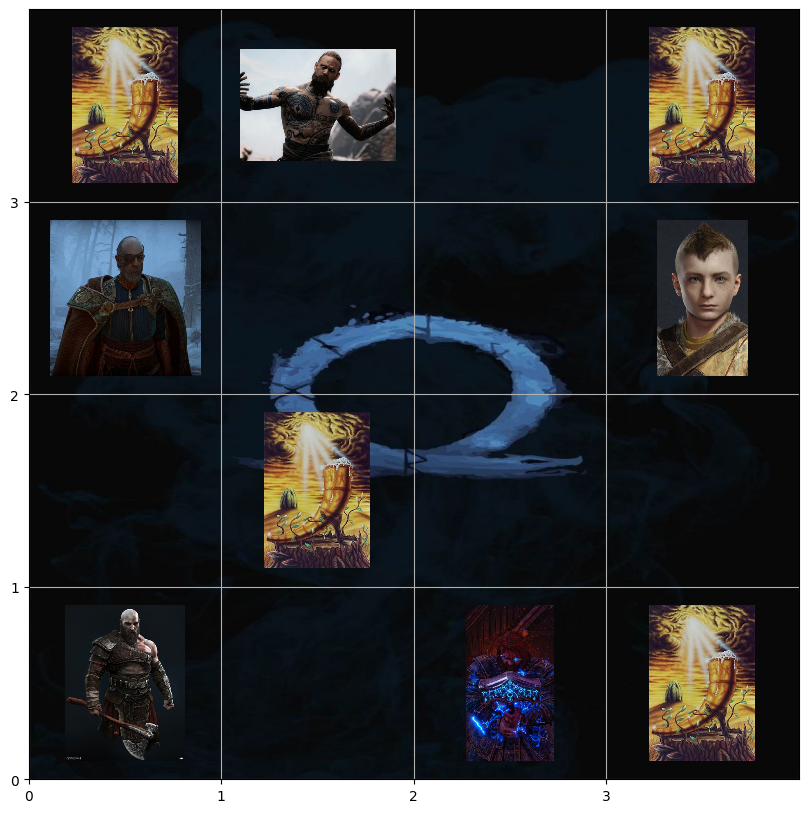

In [5]:
environment = GodOfWar()
environment.reset()
environment.render(plot=True)

# **Random Agent**

In [6]:
class RandomAgent:

  def __init__(self,environment):
    self.environment = environment
    self.observation_space = environment.observation_space
    self.action_space = environment.action_space

  def step(self,obs):
    return np.random.choice(self.action_space.n)

Observation: [1 0] Action: 0 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


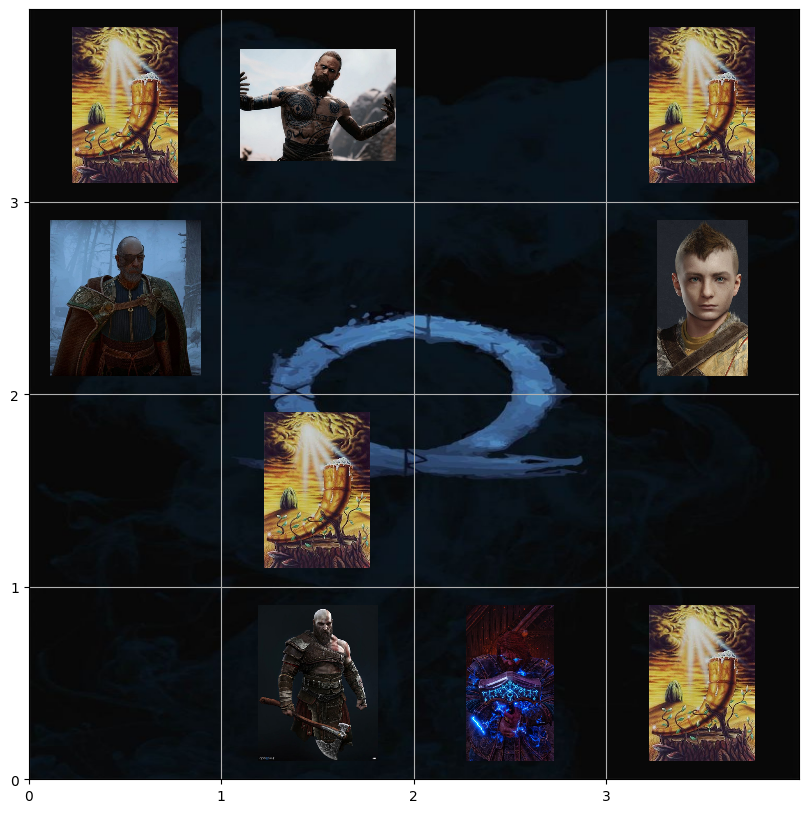

Observation: [0 0] Action: 1 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


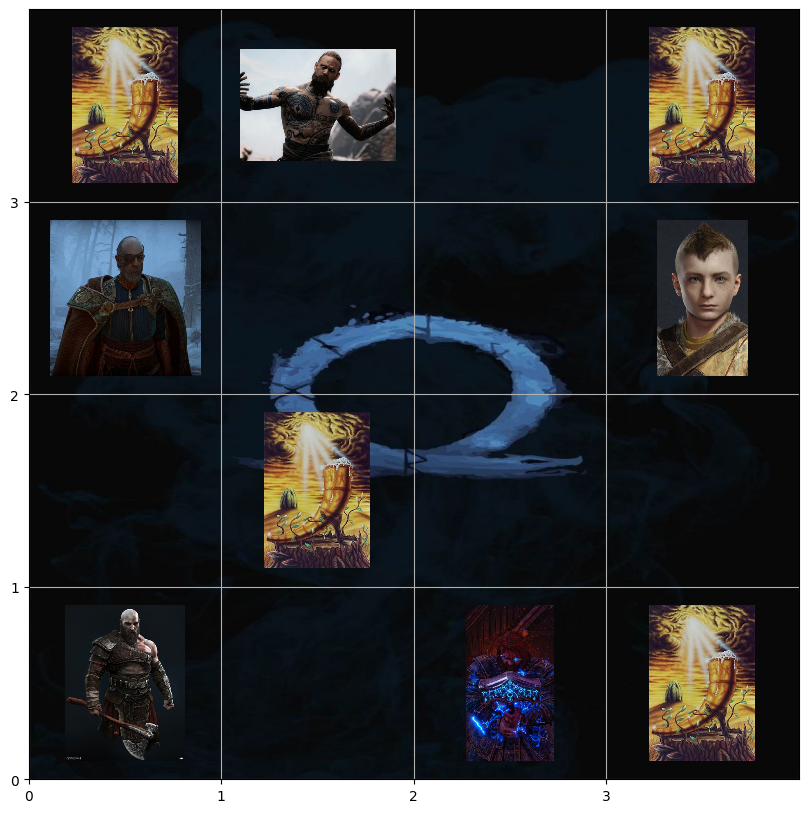

Observation: [1 0] Action: 0 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


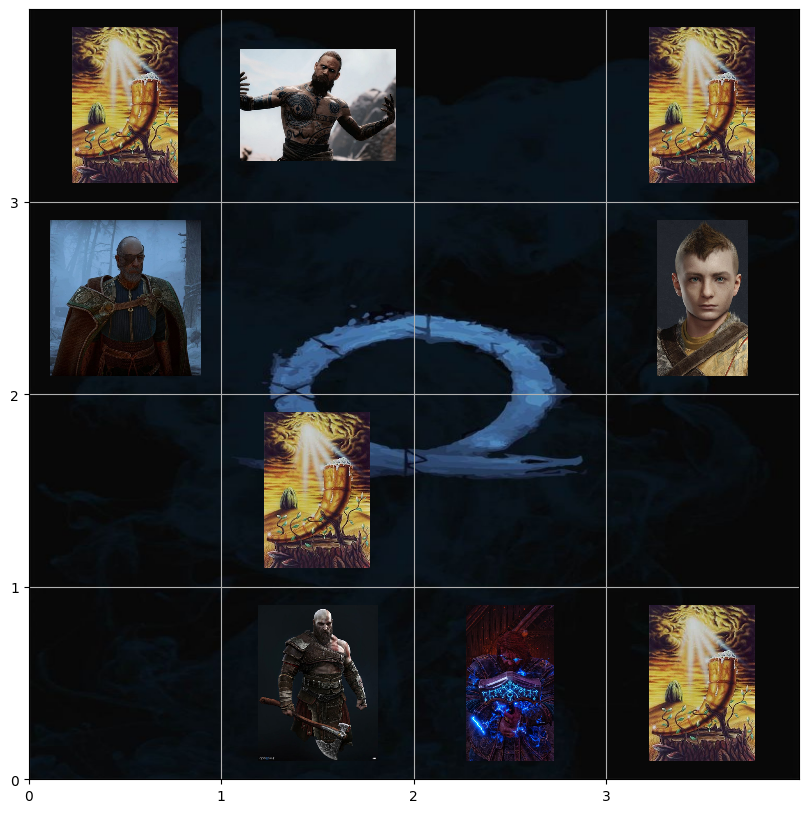

Observation: [2 0] Action: 0 , Reward: -30 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


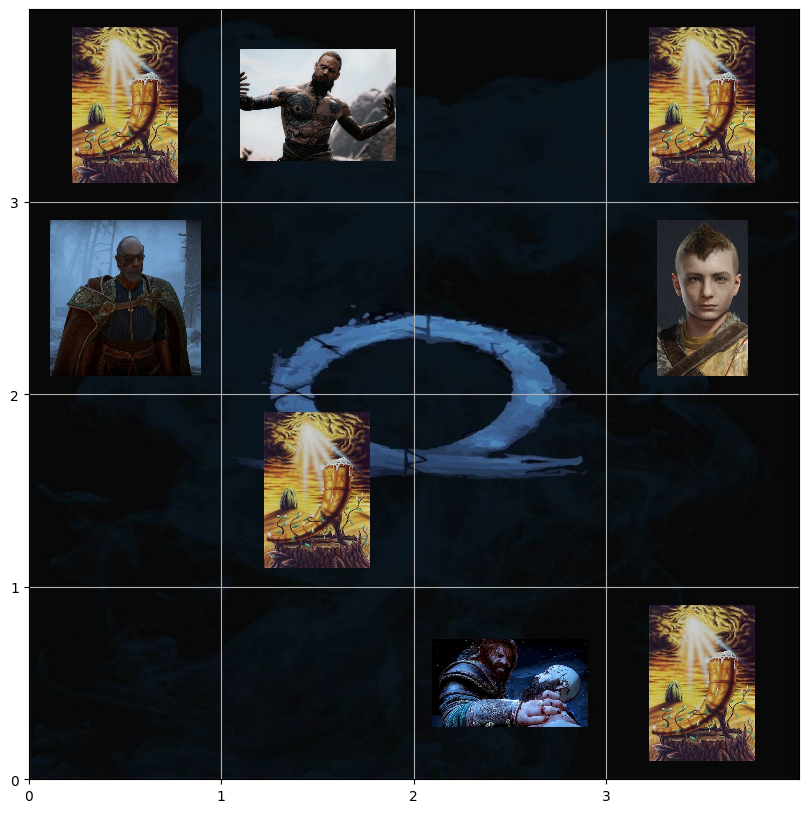

Observation: [2 0] Action: 3 , Reward: -30 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


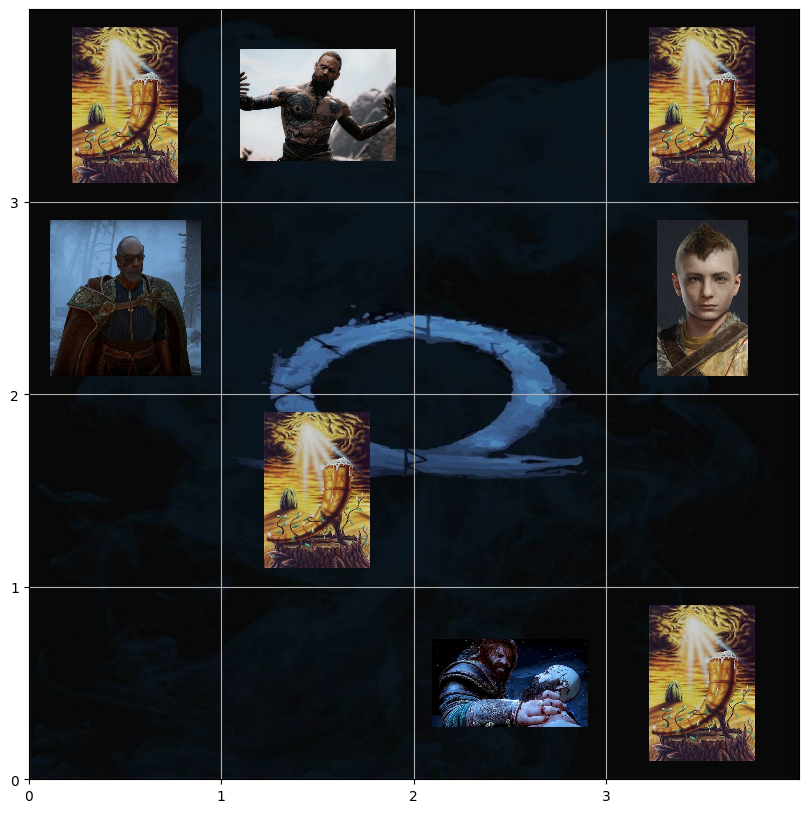

Observation: [2 1] Action: 2 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


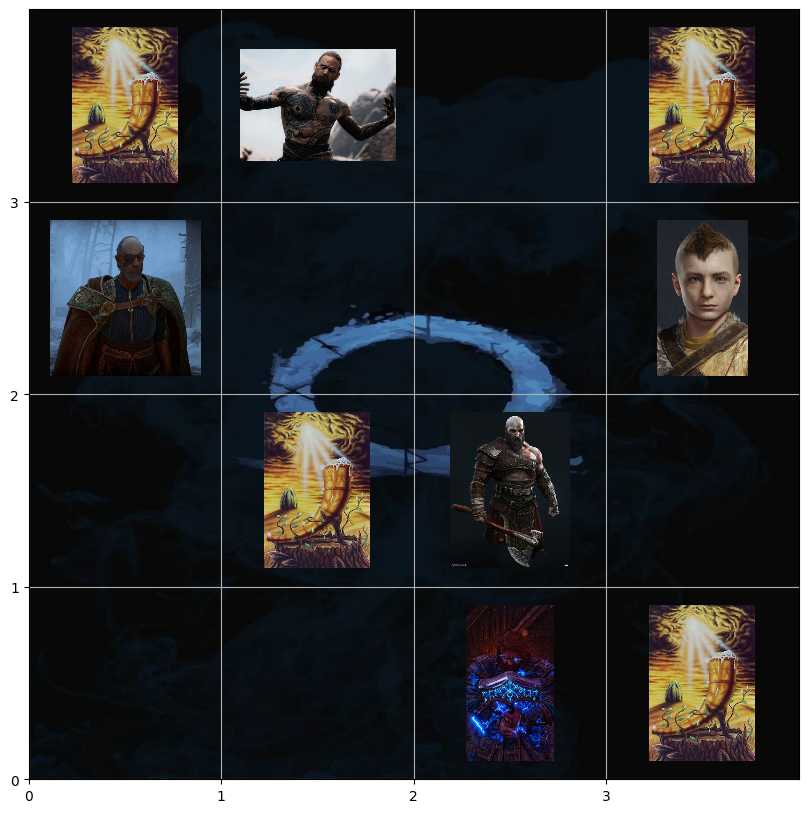

Observation: [3 1] Action: 0 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


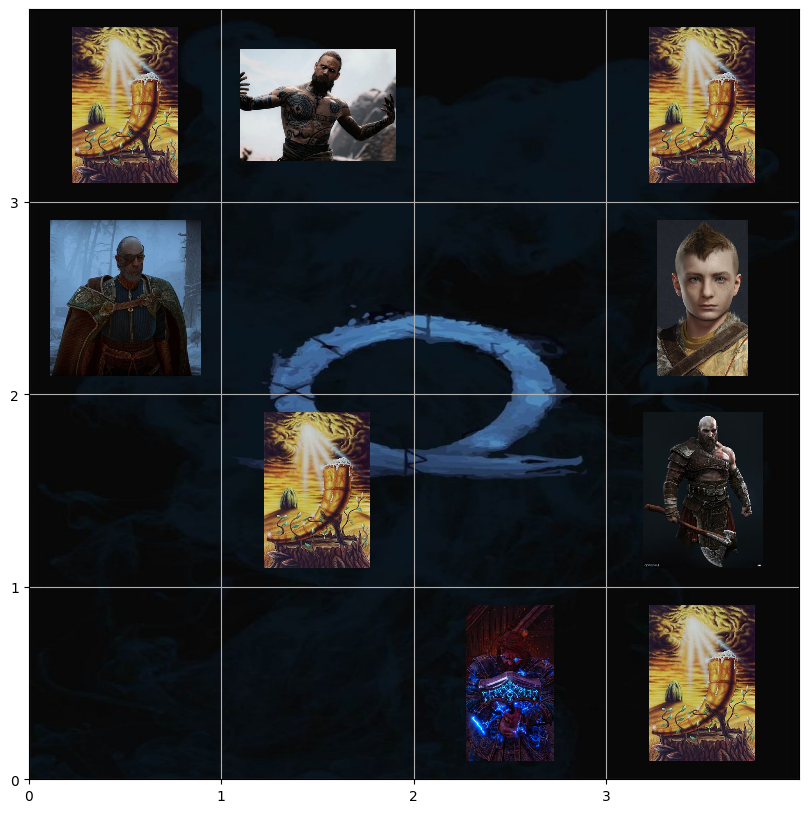

Observation: [2 1] Action: 1 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


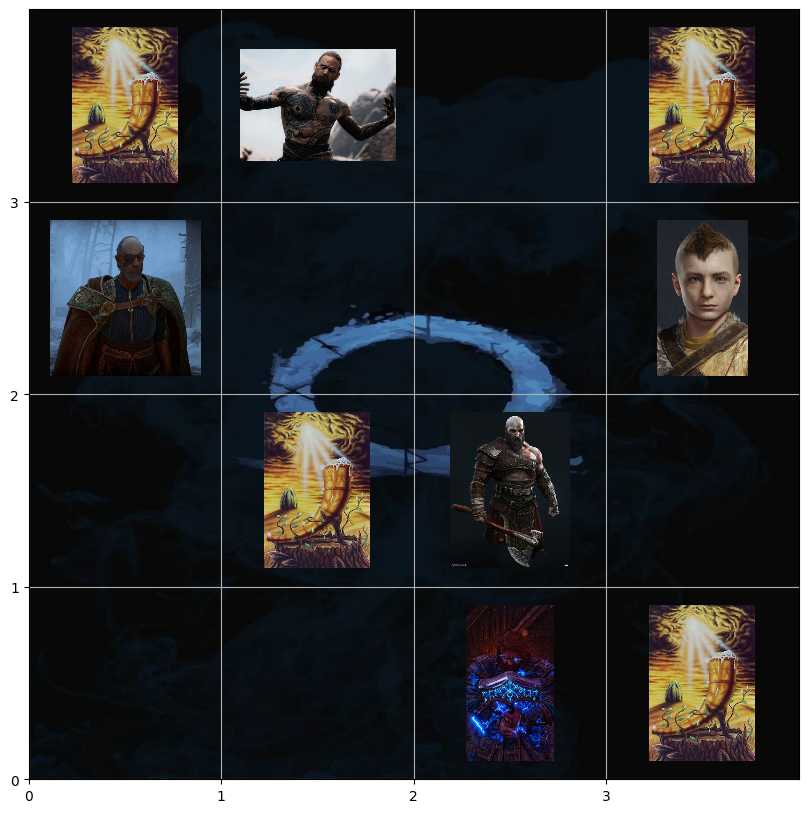

Observation: [1 1] Action: 1 , Reward: 3 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


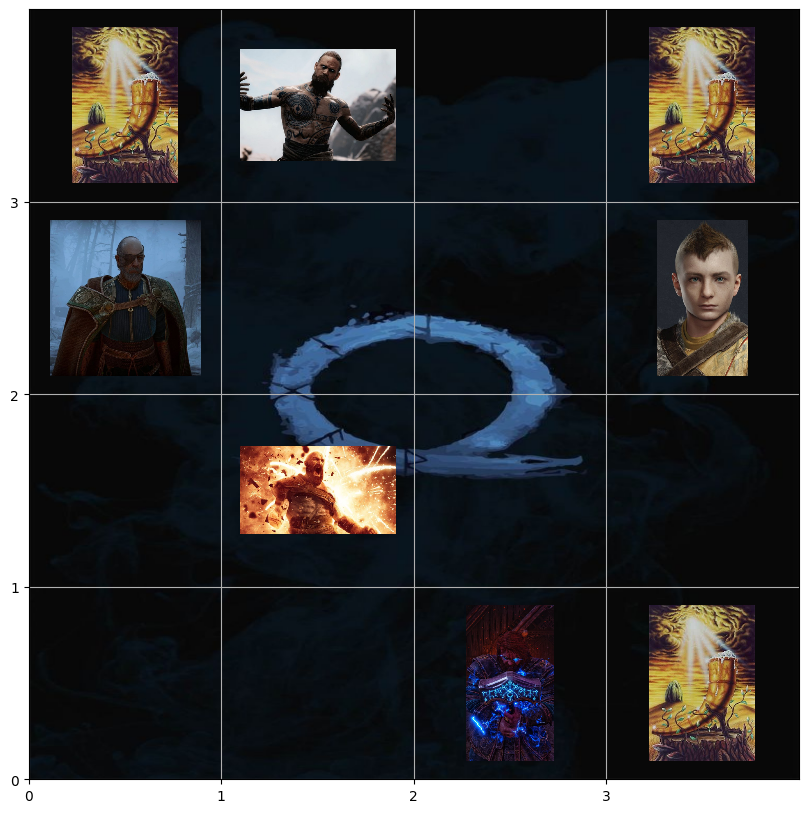

Observation: [1 2] Action: 2 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


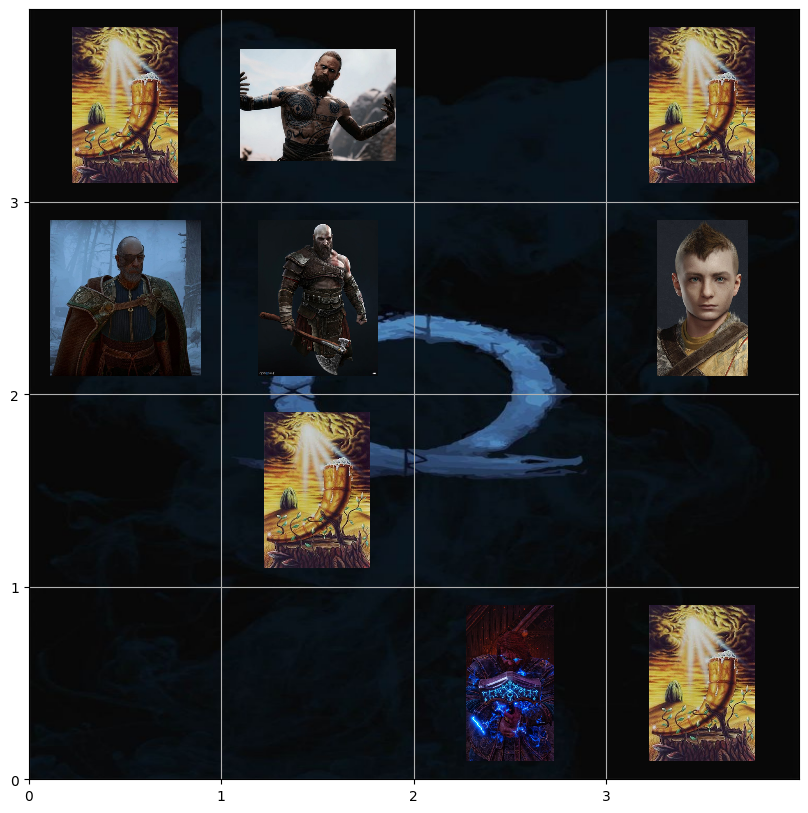

Observation: [0 2] Action: 1 , Reward: -50 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


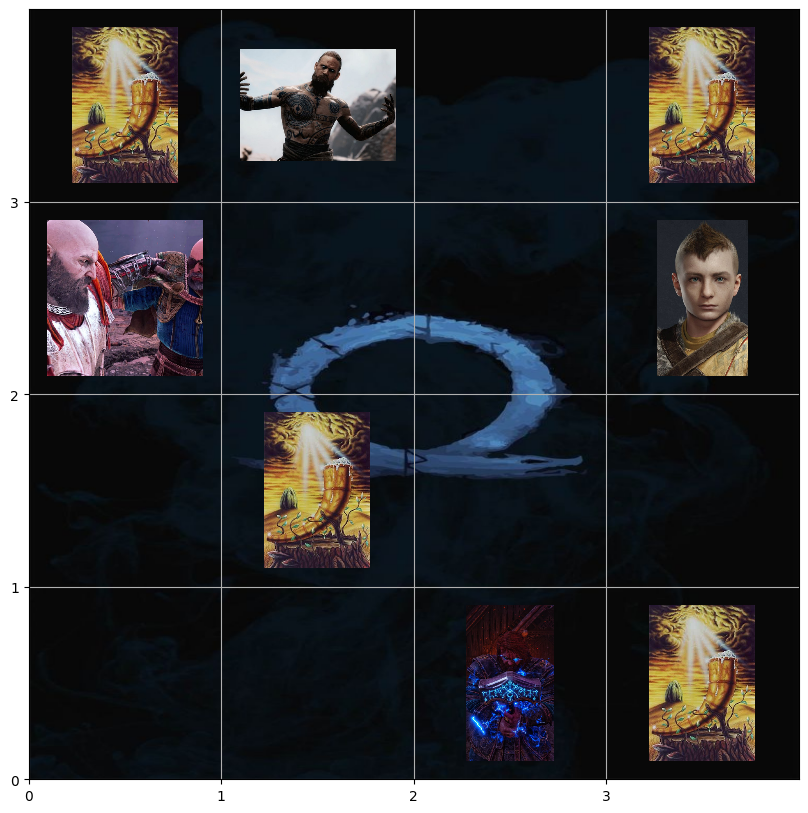

Observation: [0 2] Action: 1 , Reward: -50 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


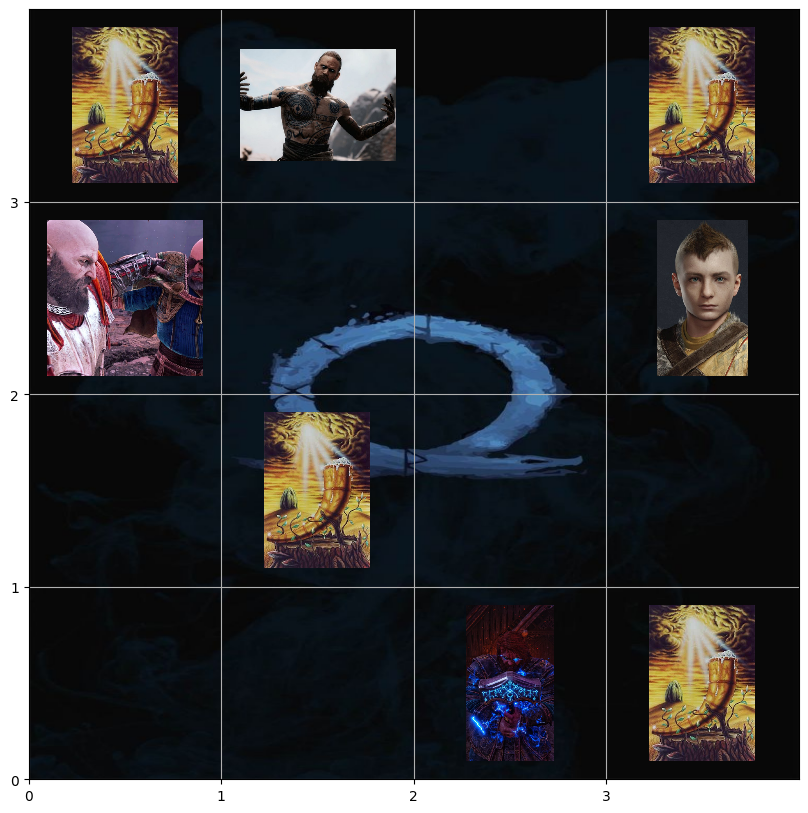

Observation: [0 2] Action: 1 , Reward: -50 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


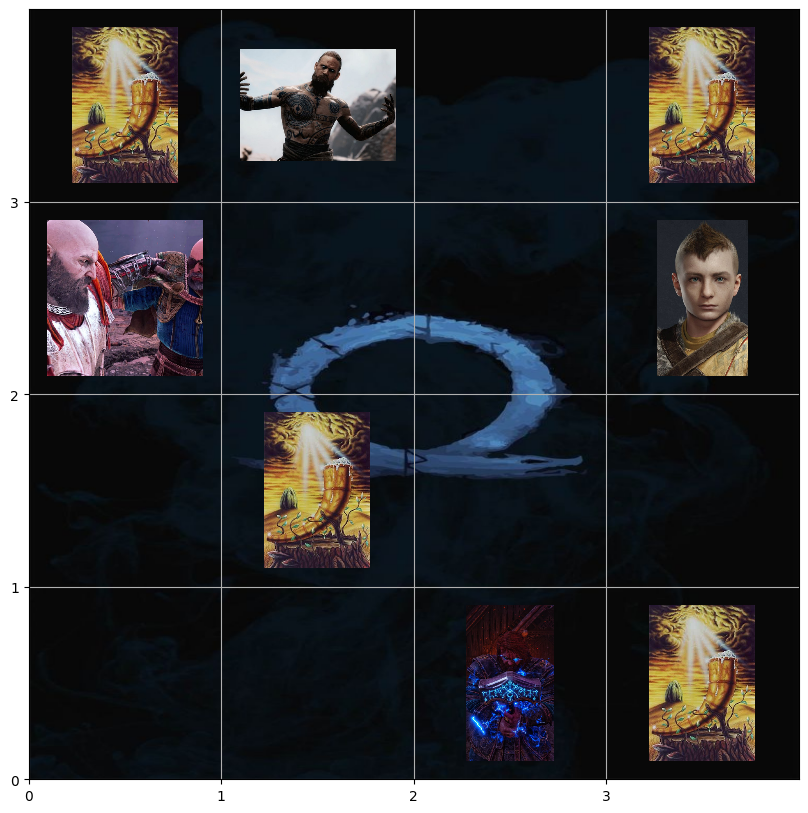

Observation: [0 1] Action: 3 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


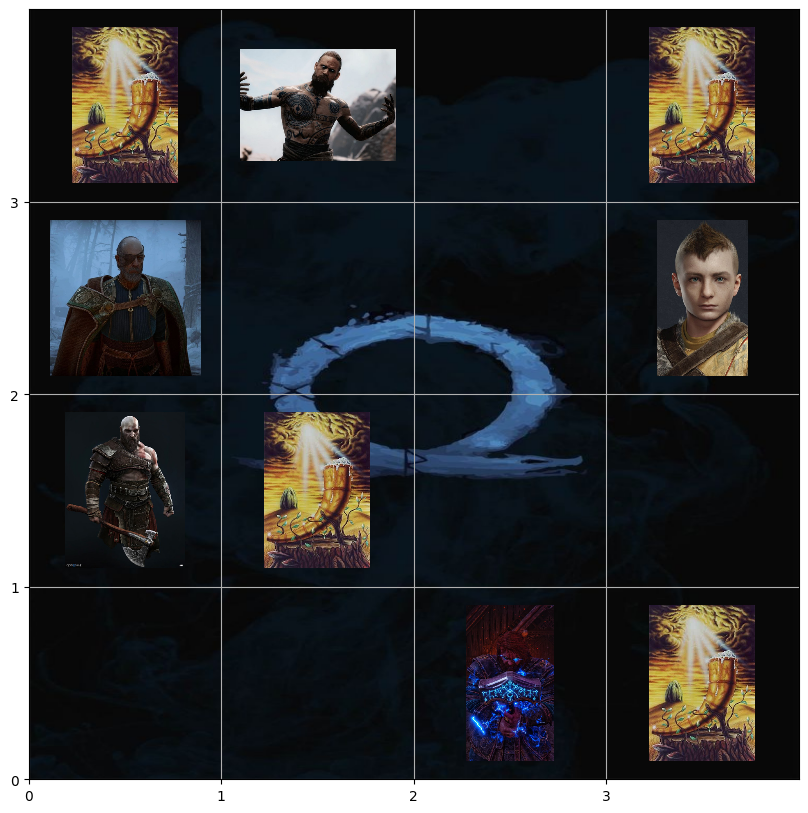

Observation: [0 0] Action: 3 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


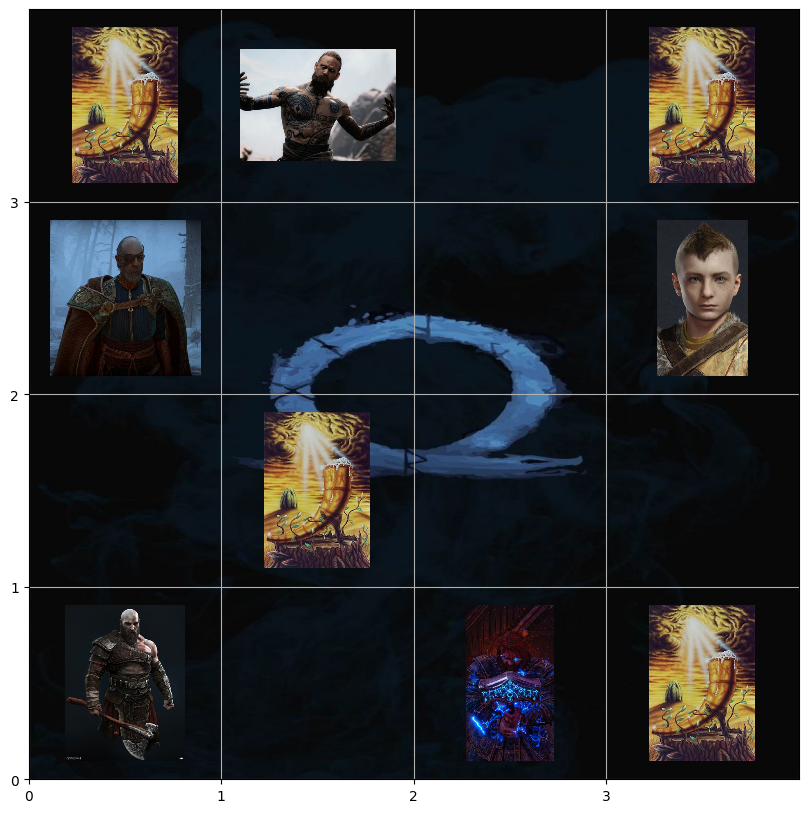

Observation: [0 1] Action: 2 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


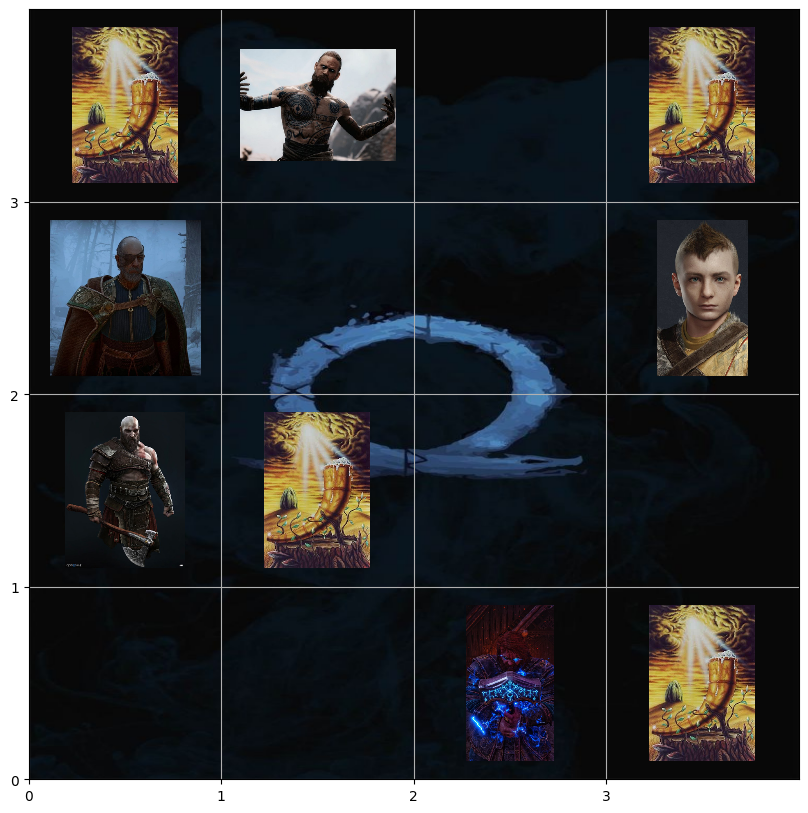

Observation: [1 1] Action: 0 , Reward: 3 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


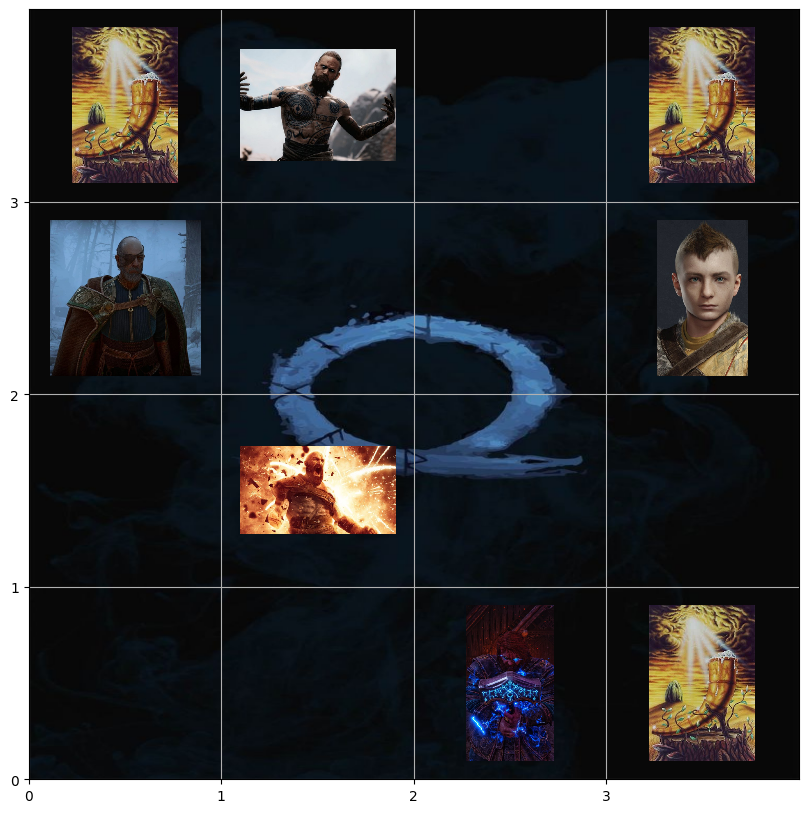

Observation: [2 1] Action: 0 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


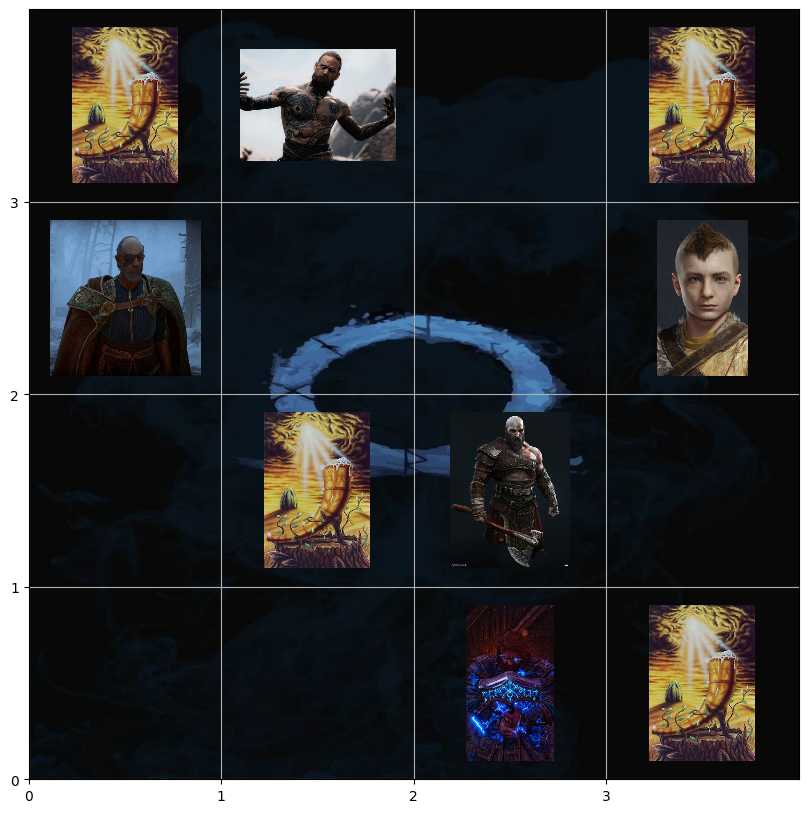

Observation: [2 0] Action: 3 , Reward: -30 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


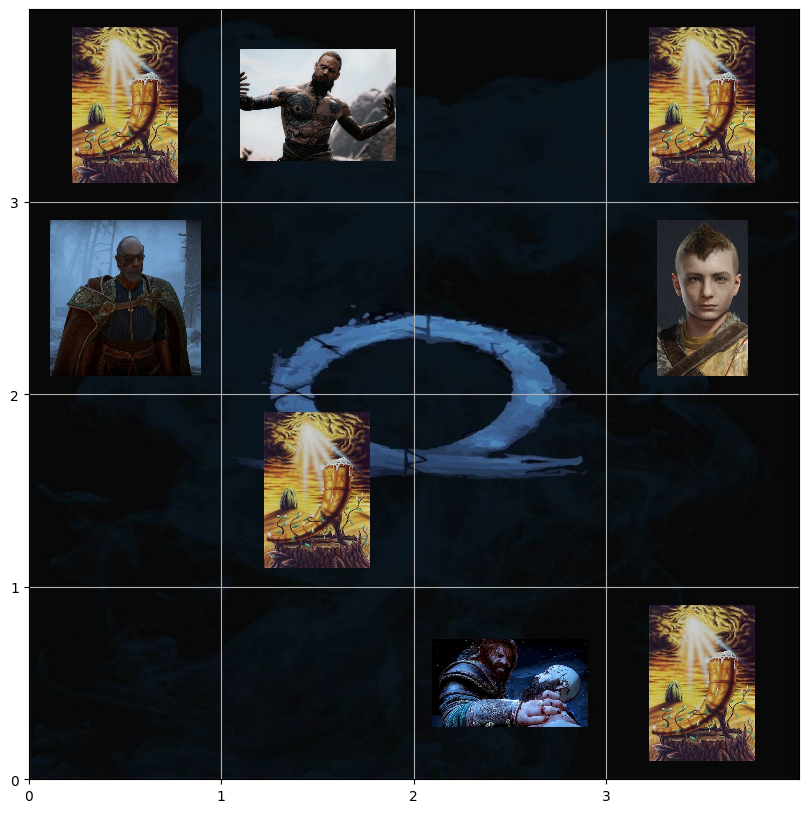

Observation: [1 0] Action: 1 , Reward: 0 Done: Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


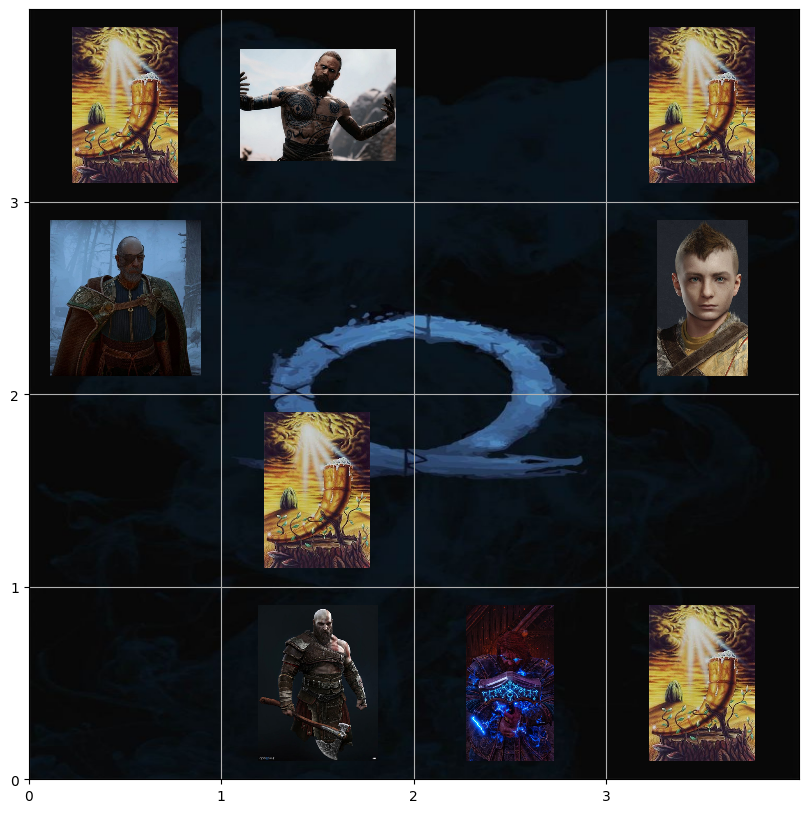

In [7]:
environment = GodOfWar()
agent = RandomAgent(environment)

obs = environment.reset()

terminated = False
while not terminated:
  action = agent.step(obs)
  obs, reward, terminated, info = environment.step(action)

  print('Observation:', obs, 'Action:', action, ', Reward:', reward, 'Done:', 'Info:', info)
  environment.render(plot=True)

#Stochastic Environment and Random Agent


In [8]:
def make_environment_stochastic(environment):
    original_step = environment.step

    def stochastic_step(action):
        # Introduce randomness:
        if np.random.rand() < 0.9:  #90% chance
            return original_step(action)
        else:  #10% chance to take a random action
            random_action = environment.action_space.sample()
            return original_step(random_action)

    environment.step = stochastic_step

Observation: [0 0] Action: 1 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


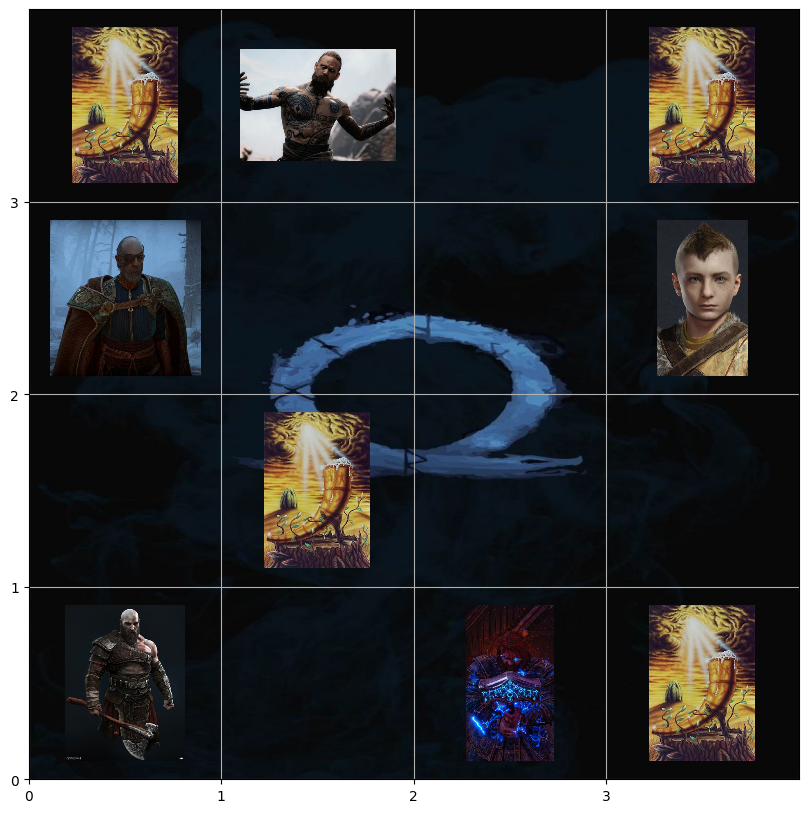

Observation: [0 0] Action: 3 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


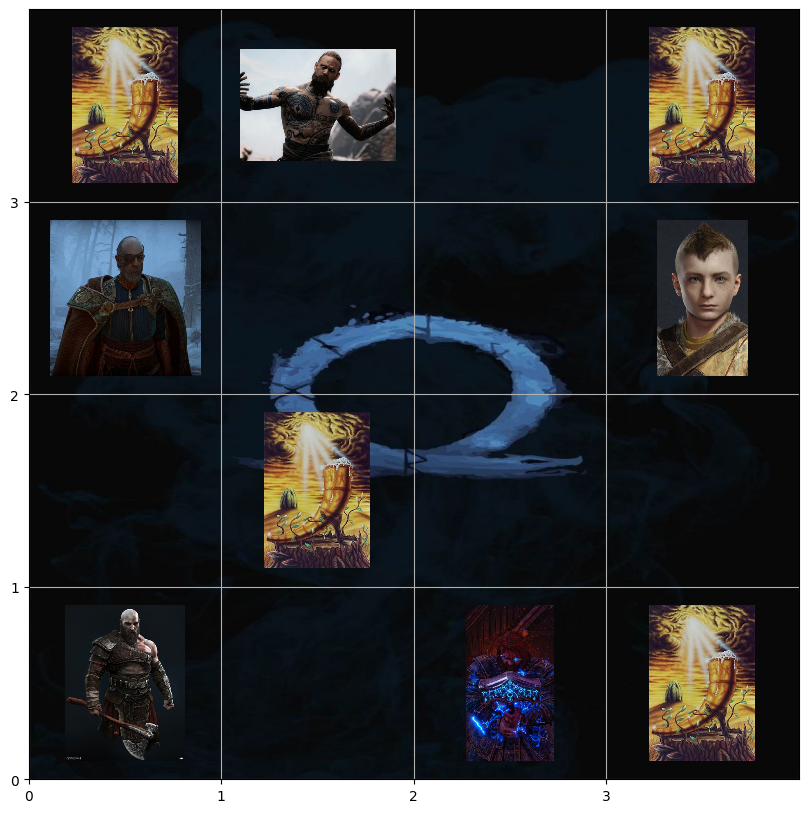

Observation: [0 0] Action: 3 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


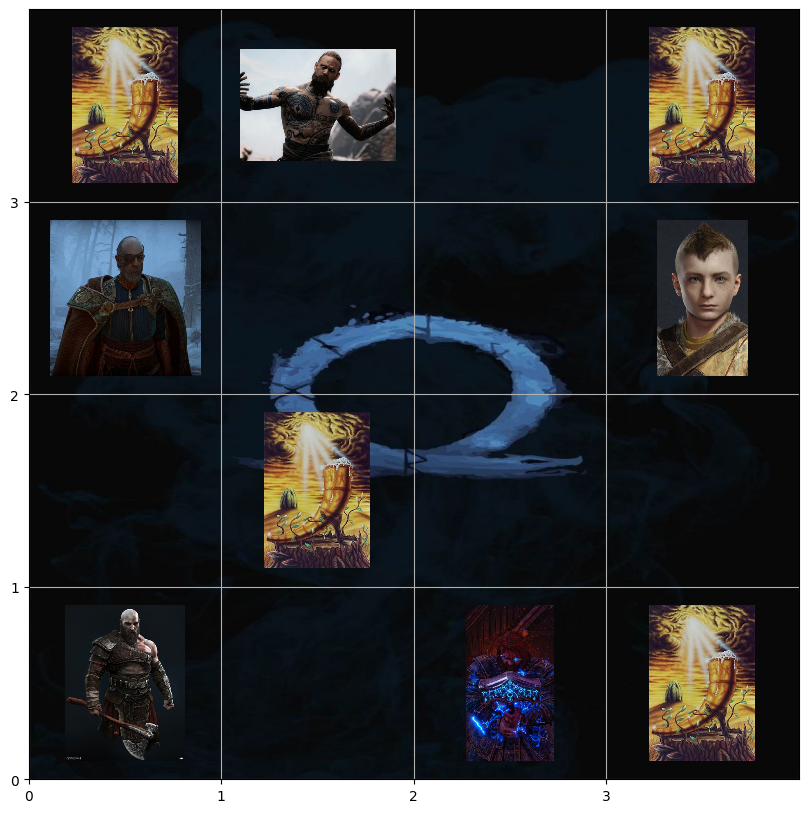

Observation: [0 1] Action: 2 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


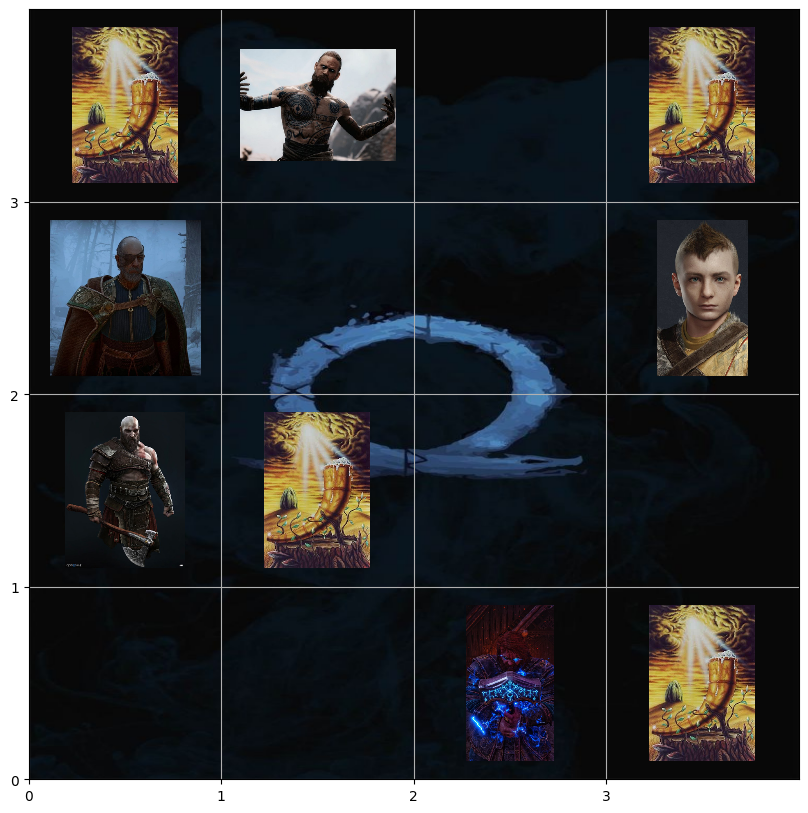

Observation: [0 0] Action: 3 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


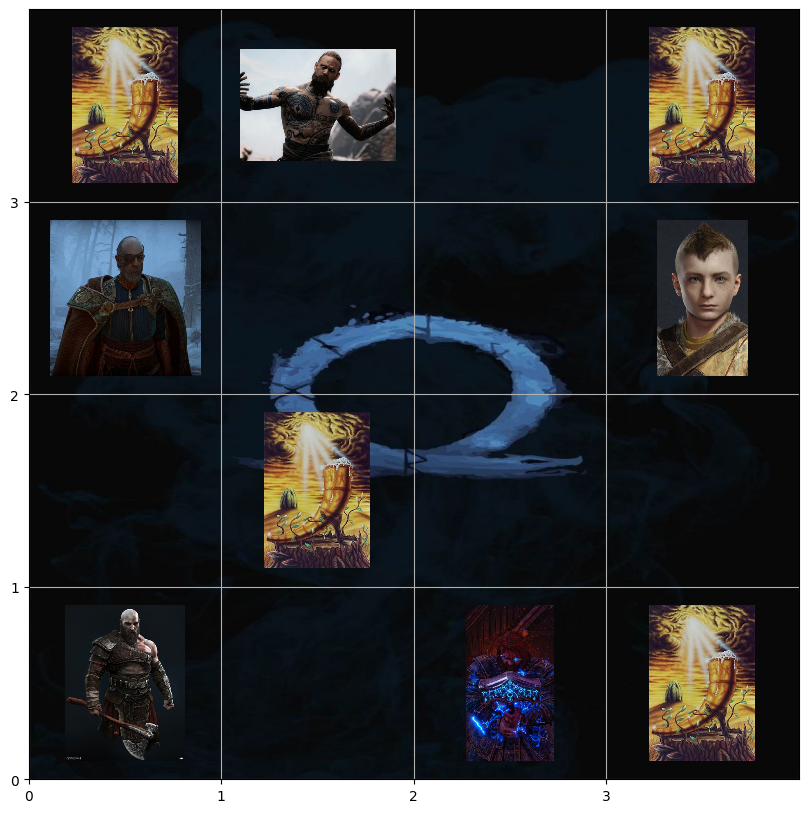

Observation: [0 0] Action: 1 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


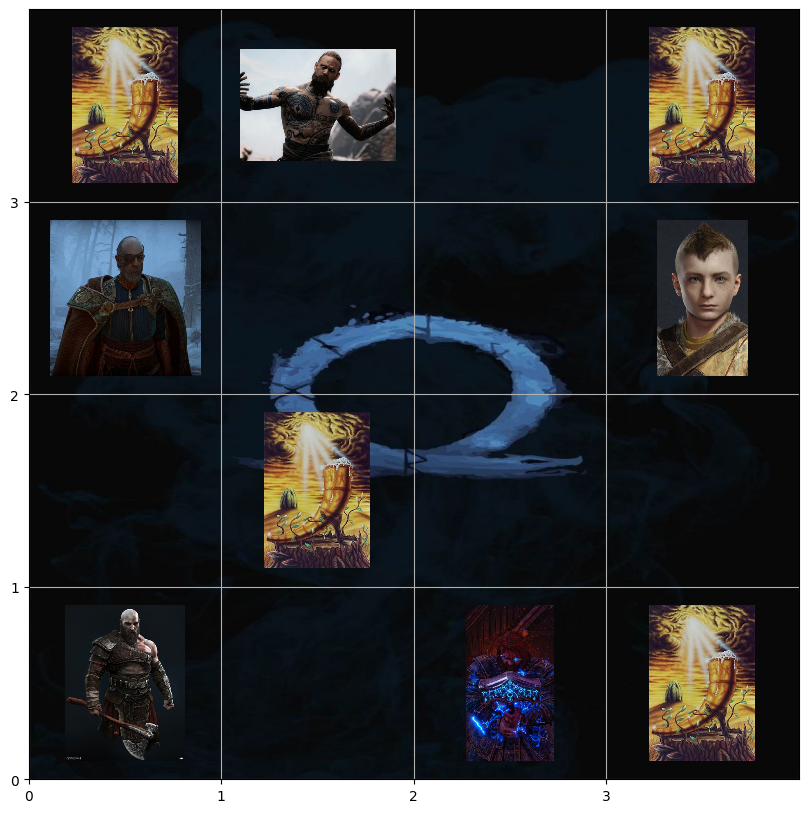

Observation: [1 0] Action: 0 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


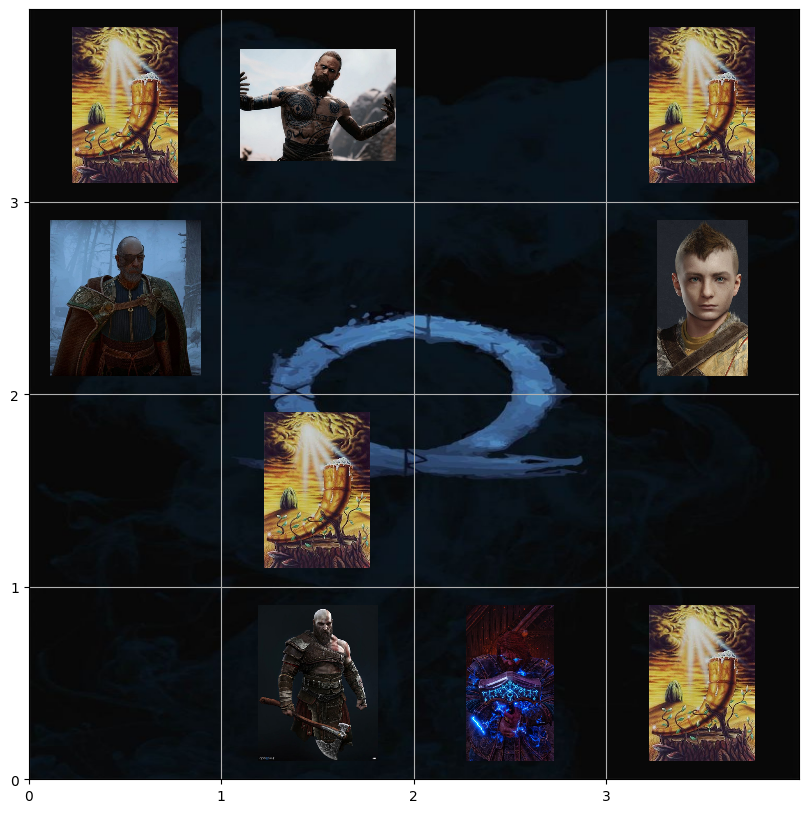

Observation: [1 0] Action: 3 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


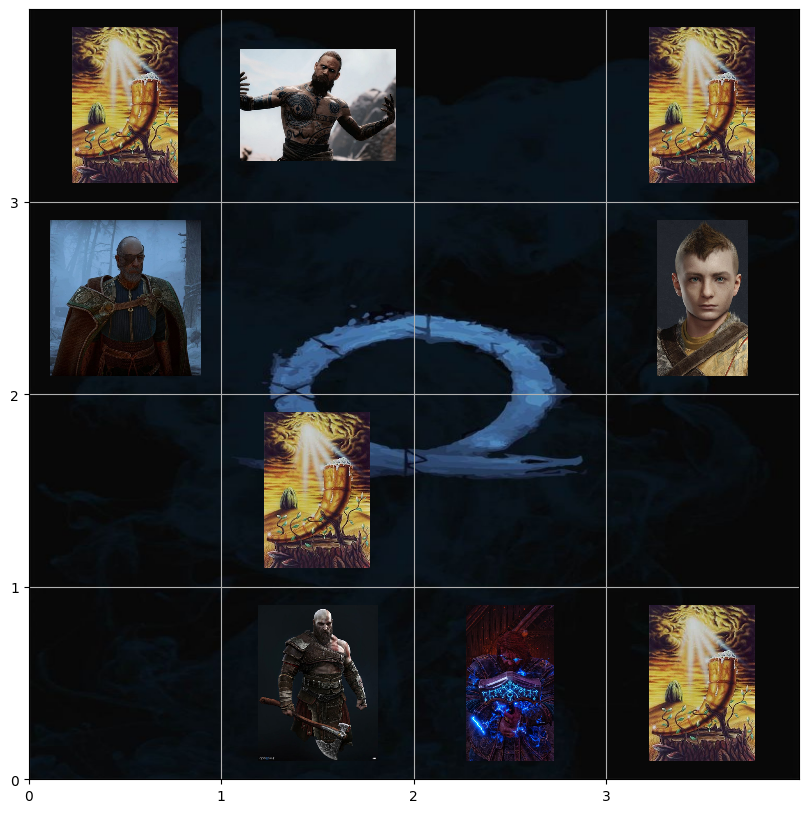

Observation: [0 0] Action: 1 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


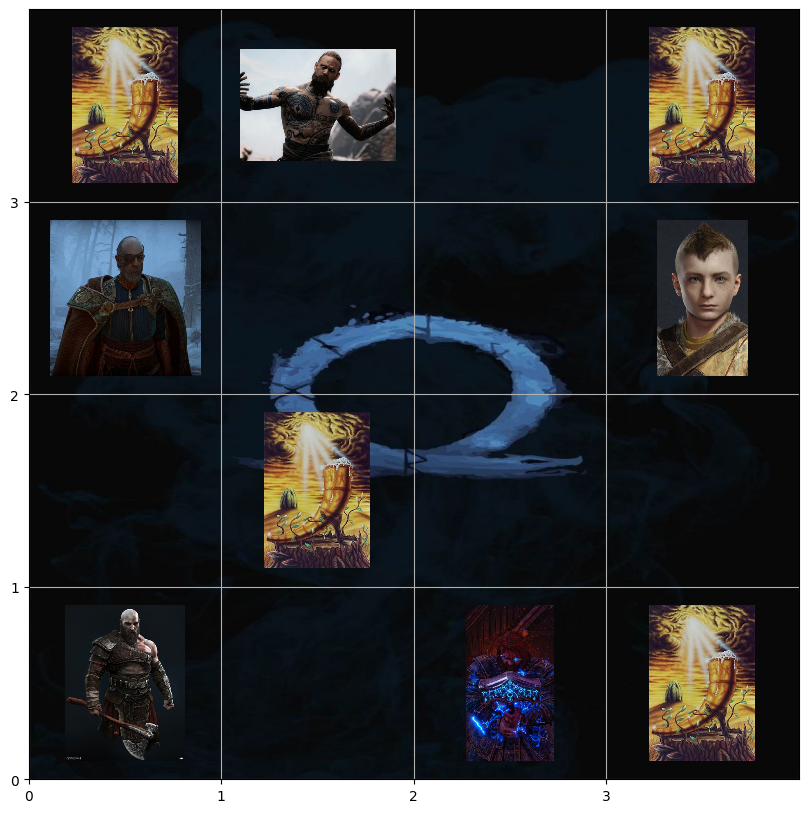

Observation: [0 0] Action: 1 , Reward: 0 Done: False Info: {'Adventure_result': 'Do Not Mistake My Silence For Lack Of Grief.'}


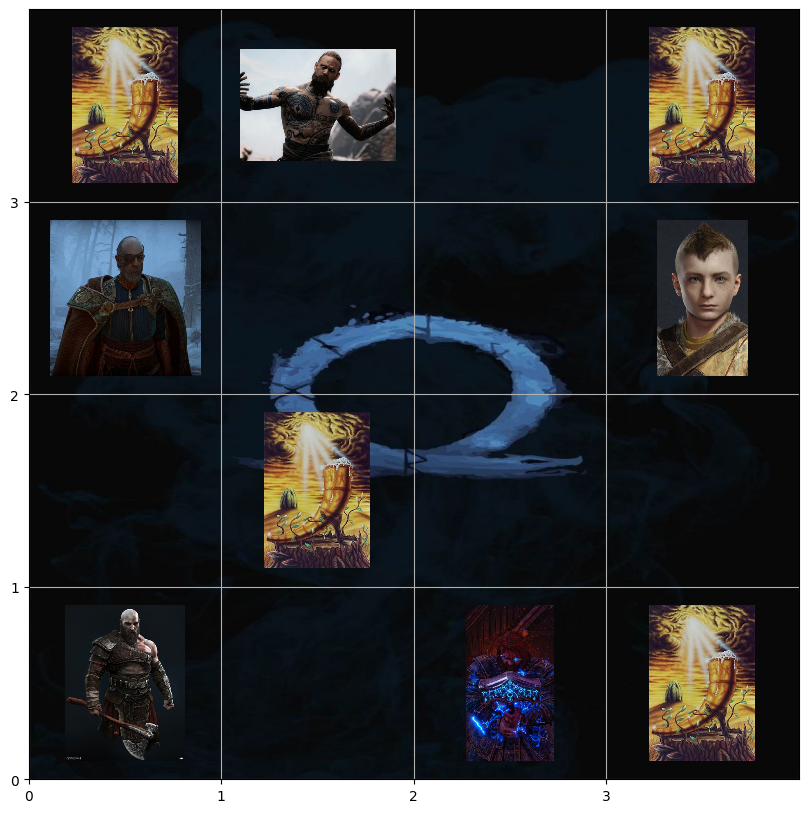

In [9]:
environment = GodOfWar()
make_environment_stochastic(environment)  #Apply stochasticity to the environment

environment.reset()

for _ in range(10):  #TImestep is 10
    action = environment.action_space.sample()
    obs, reward, done, info = environment.step(action)
    print('Observation:', obs, 'Action:', action, ', Reward:', reward, 'Done:', done, 'Info:', info)
    environment.render()

    if done:
        environment.reset()
